In [1]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import textwrap
from mymain import parser, Character, people

characters = parser()
shortened = [
    "King Charles",
    "Cardinal Orsini",
    "Father Mario Maffei",
    "Queen Isabella I",
    "Cardinal della Rovere di Vinovo",
    "Papal Chaplain Alessandro Farnese",
    "Cardinal Federico Sanseverino",
    "Cesare “Valentino” Borgia",
    "Gioacchino Torriani,",
    "Cardinal René de Prie",
    "Cardinal Giovanni Conti",
    "Father Dioneo Farnese",
    "Pierre D’Aubusson",
    "Captain Corella",
    "Francesco Alidosi",
    "Chef Bocca",
    "Caterina Sforza Riario",
    "Cardinal Giovanni Michiel Zen",
    "Cardinal Paolo Campofregoso",
    "Agostino Tillio",
    "Adriano “Hadrian” Castellesi",
    "Cardinal Rodrigo Borgia",
    "Brother Vincenzo Bandello",
    "Cardinal Jorge da Costa",
    "Antonio Pallavicini Gentili",
    "Duchess Anne of Brittany",
    "Cardinal Ippolito d’Este",
    "Raffaele Riario (della Rovere)",
    "Franceschetto Cybo",
    "Cardinal Girolamo",
    "Francesco “Samson” Nanni",
    "Queen Beatrice",
    "Cardinal Giovanni Colonna",
    "King Louis of Orleans",
    "Doctor John Argentine",
    "Cardinal Giuliano della Rovere",
    "Giovanni Battista Zen",
    "Duke Louis of Orleans",
    "Galahad Sanseverino",
    "Johann Burchard",
    "Cardinal Sforza",
    "Cardinal Oliverio Carafa",
    "Cardinal Guillaume Briçonnet",
    "Brother Constantine (Prince Cem)",
    "Cardinal Matthäus Schiner",
    "Cardinal Pietro Bembo",
    "Emperor Maximilian I",
    "Cardinal Piccolomini",
    "Maffeo Gherardi, Patriarch of Venice",
    "Cardinal Michel de Bucy",
    "Cardinal Giovanni “Leo” de Medici",
    "Brother Tillio",
    "Josquin des Prez",
    "Cardinal Giovanni Battista Savelli",
    "Gherardo Maffei",
    "Cardinal Francesco Soderini",
    "King Henry VII",
    "Giovanni “Achilles” Sangiorgio",
    "Adriano “Hadrian” Castellesi",
    "Brother Annio of Viterbo",
    "Raffaello Maffei “Volterrano”",
    # "Cardinal della Porta Junior",
    "Michele Tarchaniota Marullo",
]

labels = {"the roman mob": "The Roman Mob"}
for i in range(len(shortened)):
    labels[people[i]] = shortened[i]

/var/folders/l1/gkkkp_tx023b7x0919gyc83m0000gn/T/ipykernel_99235/4099501033.py:30: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df = df.fillna(df.max().max())


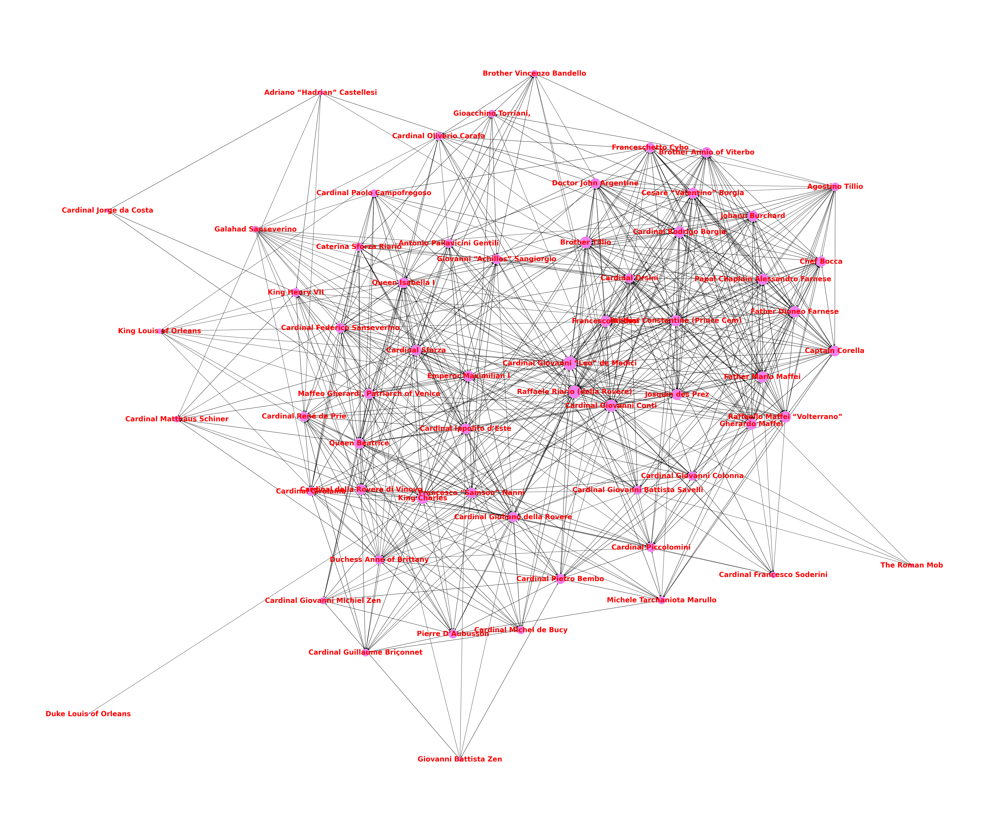

In [2]:
#Create a blank graph page
nxG = nx.DiGraph(directed=True)

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
        for relation in characters[ch].relationsFiltered[key]:
            if relation != characters[ch]:
                nxG.add_edge(name, labels[relation.name.lower()])
        
#Add nodes


# #Add edges
# nxG.add_edge(x, y)

# #Lists
# nodeSizes = [1000, 20]
# color_map = ['red', 'blue']
df = pd.DataFrame(index=nxG.nodes(), columns=nxG.nodes())
for row, data in nx.shortest_path_length(nxG):
    for col, dist in data.items():
        df.loc[row,col] = dist

df = df.fillna(df.max().max())
layout = nx.kamada_kawai_layout(nxG, dist=df.to_dict())

# layout = nx.random_layout(nxG)
color_map = []
for node in nxG:
    color_map.append("violet")
plt.rcParams["figure.figsize"] = (60,50)

list_degree=list(nxG.degree())
nodes , degree = map(list, zip(*list_degree)) 
nx.draw(nxG, pos=layout, with_labels=True, font_size=30, node_color=color_map, font_color="red", font_weight="bold", node_size=[(v * 50)+1 for v in degree])
plt.show()

/var/folders/l1/gkkkp_tx023b7x0919gyc83m0000gn/T/ipykernel_99235/277729724.py:22: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df = df.fillna(df.max().max())


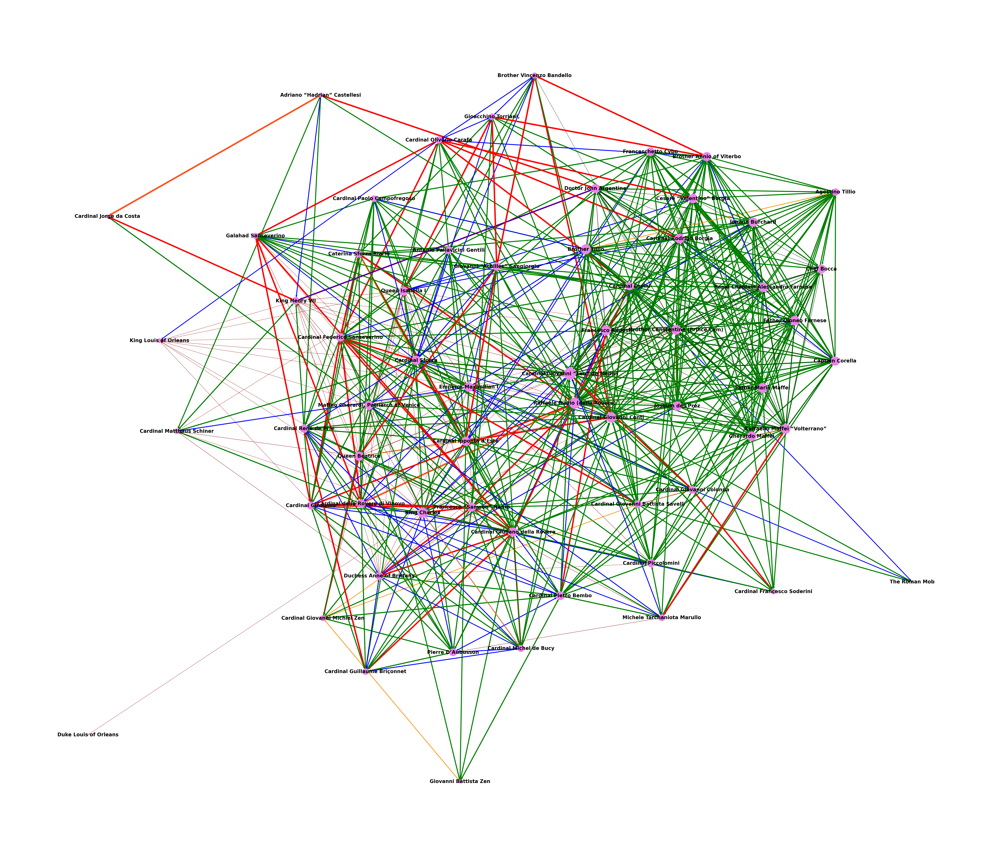

In [24]:
nxG = nx.DiGraph(directed=True)

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

colors = {"close ally": "red", "ally": "green", "confidant": "darkorange", "client": "blue", "correspondent": "maroon", "patron": "blue", "boss": "darkgreen", "colleague": "black"}
myweights = {"close ally": 7, "ally": 5, "confidant": 3, "client": 4, "correspondent": 1, "patron":4, "boss": 2, "colleague": 1}
for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
        for relation in characters[ch].relationsFiltered[key]:
            if relation != characters[ch]:
                nxG.add_edge(name, labels[relation.name.lower()],color=colors[key], weight=myweights[key])
        
df = pd.DataFrame(index=nxG.nodes(), columns=nxG.nodes())
for row, data in nx.shortest_path_length(nxG):
    for col, dist in data.items():
        df.loc[row,col] = dist

df = df.fillna(df.max().max())
layout = nx.kamada_kawai_layout(nxG, dist=df.to_dict())

color_map = []
for node in nxG:
    color_map.append("violet")
plt.rcParams["figure.figsize"] = (70,60)

list_degree=list(nxG.degree())
nodes , degree = map(list, zip(*list_degree)) 
colorings = nx.get_edge_attributes(nxG,'color').values()
weights = nx.get_edge_attributes(nxG,'weight').values()

nx.draw(nxG, pos=layout, with_labels=True, font_size=25, node_color=color_map,edge_color=colorings, width=list(weights), font_color="black", font_weight="bold", node_size=[(v * 50)+1 for v in degree])
plt.show()

/var/folders/l1/gkkkp_tx023b7x0919gyc83m0000gn/T/ipykernel_99235/3198724821.py:32: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df = df.fillna(df.max().max())


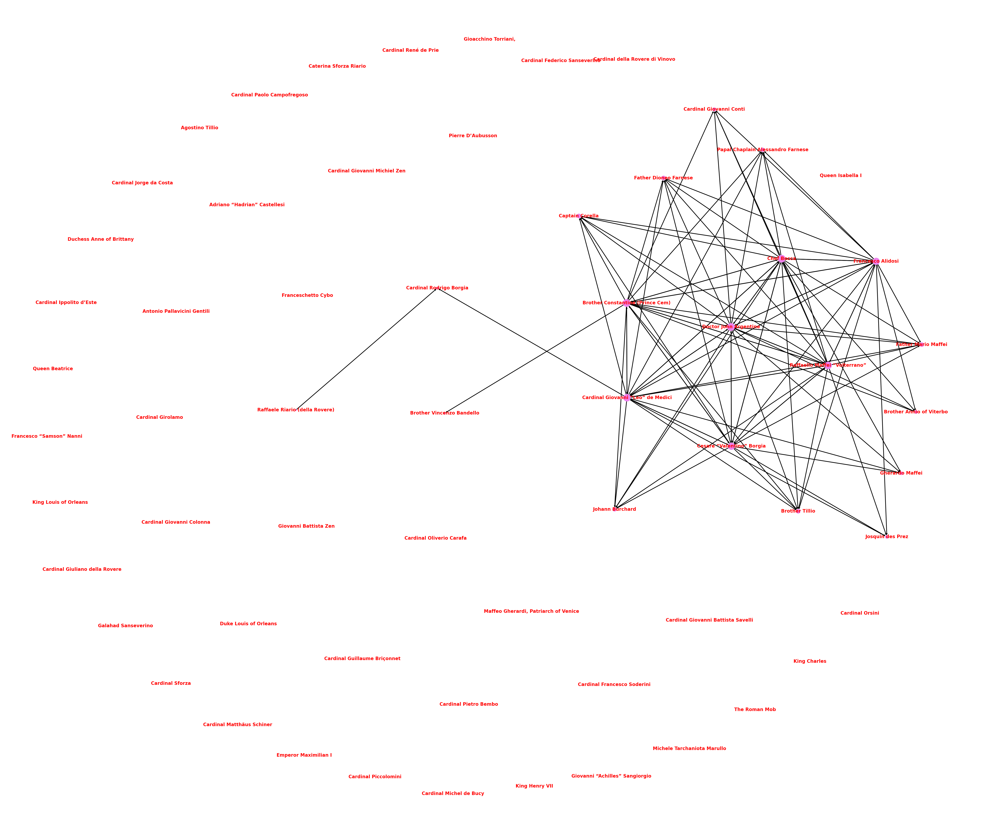

In [42]:
nxG = nx.DiGraph(directed=True)

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

colors = {"close ally": "red", "ally": "green", "confidant": "black", "client": "blue", "correspondent": "darkblue", "patron": "blue", "boss": "darkgreen", "colleague": "black"}
myweights = {"close ally": 2, "ally": 1, "confidant": 2, "client": 5, "correspondent": 2, "patron": 5, "boss": 3, "colleague": 3}
for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if "colleague" in key:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()],color=colors[key], weight=myweights[key])
        
#Add nodes


# #Add edges
# nxG.add_edge(x, y)

# #Lists
# nodeSizes = [1000, 20]
# color_map = ['red', 'blue']
df = pd.DataFrame(index=nxG.nodes(), columns=nxG.nodes())
for row, data in nx.shortest_path_length(nxG):
    for col, dist in data.items():
        df.loc[row,col] = dist

df = df.fillna(df.max().max())
layout = nx.kamada_kawai_layout(nxG, dist=df.to_dict())

color_map = []
for node in nxG:
    color_map.append("violet")
plt.rcParams["figure.figsize"] = (60,50)

list_degree=list(nxG.degree())
nodes , degree = map(list, zip(*list_degree)) 
colorings = nx.get_edge_attributes(nxG,'color').values()
weights = nx.get_edge_attributes(nxG,'weight').values()

nx.draw(nxG, pos=layout, with_labels=True, font_size=20, node_color=color_map, edge_color=colorings, width=list(weights), font_color="red", font_weight="bold", node_size=[(v * 50)+1 for v in degree])
plt.show()

In [66]:
"""
Strength of the social network
"""

nxG = nx.Graph(directed=True)

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        # if "ally" in key:
        characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
        for relation in characters[ch].relationsFiltered[key]:
            if relation != characters[ch]:
                nxG.add_edge(name, labels[relation.name.lower()],)

print(nx.algorithms.approximation.average_clustering(nxG))

0.604


Cardinal Ippolito d’Este: 30
Maffeo Gherardi, Patriarch of Venice: 11
Cardinal Giuliano della Rovere: 44
Cardinal Pietro Bembo: 22
Cardinal Giovanni Michiel Zen: 5


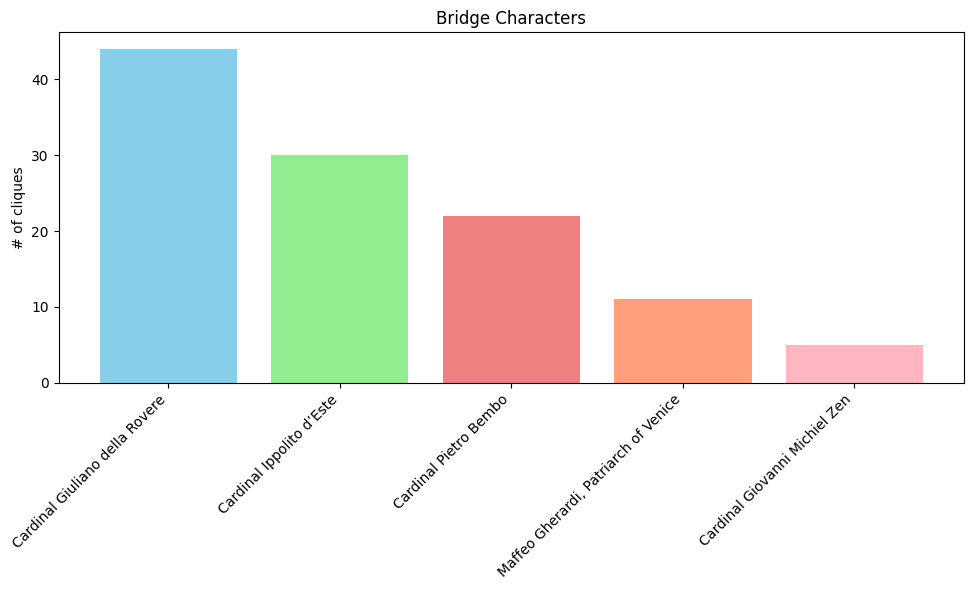

In [289]:
"""
Overlapping members of cliques (strong bridges?)
"""

nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()])

def intersection(lst1, lst2):
    lst3 = [value for value in lst1 if value in lst2]
    return lst3

clique = nx.find_cliques(nxG)
# independent_set = nx.approximation.maximum_independent_set(nxG)
# out = intersection(clique, independent_set)
# print(out)

overlaps = {}
for itm in clique:
    for alt in clique:
        if alt != itm:
            test = intersection(alt, itm)
            for n in test:
                if n in overlaps:
                    overlaps[n] += 1
                else:
                    overlaps[n] = 1

for key, value in overlaps.items():
    print(f"{key}: {value}")

overlaps = dict(sorted(overlaps.items(), key=lambda item: item[1], reverse=True))

persons = overlaps.keys()
counts = overlaps.values()

# List of colors for each bar
colors = ['skyblue', 'lightgreen', 'lightcoral', 'lightsalmon', 'lightpink']

# Create a vertical bar plot with different colors
plt.figure(figsize=(10, 6))
plt.bar(persons, counts, color=colors)

# Add titles and labels
plt.title('Bridge Characters')
plt.ylabel('# of cliques')

# Rotate the x labels for better readability
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

In [269]:
"""
Strongest community
"""

nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()])


for itm in nx.community.k_clique_communities(nxG, 15):
    for a in itm:
        print(a)
    print("\n\n\n")

Raffaele Riario (della Rovere)
Father Mario Maffei
Captain Corella
Johann Burchard
Raffaello Maffei “Volterrano”
Agostino Tillio
Josquin des Prez
Father Dioneo Farnese
Brother Tillio
Cardinal Giovanni “Leo” de Medici
Gherardo Maffei
Franceschetto Cybo
Chef Bocca
Papal Chaplain Alessandro Farnese
Brother Constantine (Prince Cem)
Doctor John Argentine
Francesco Alidosi
Brother Annio of Viterbo
Cesare “Valentino” Borgia
Cardinal Rodrigo Borgia
Cardinal Giovanni Conti






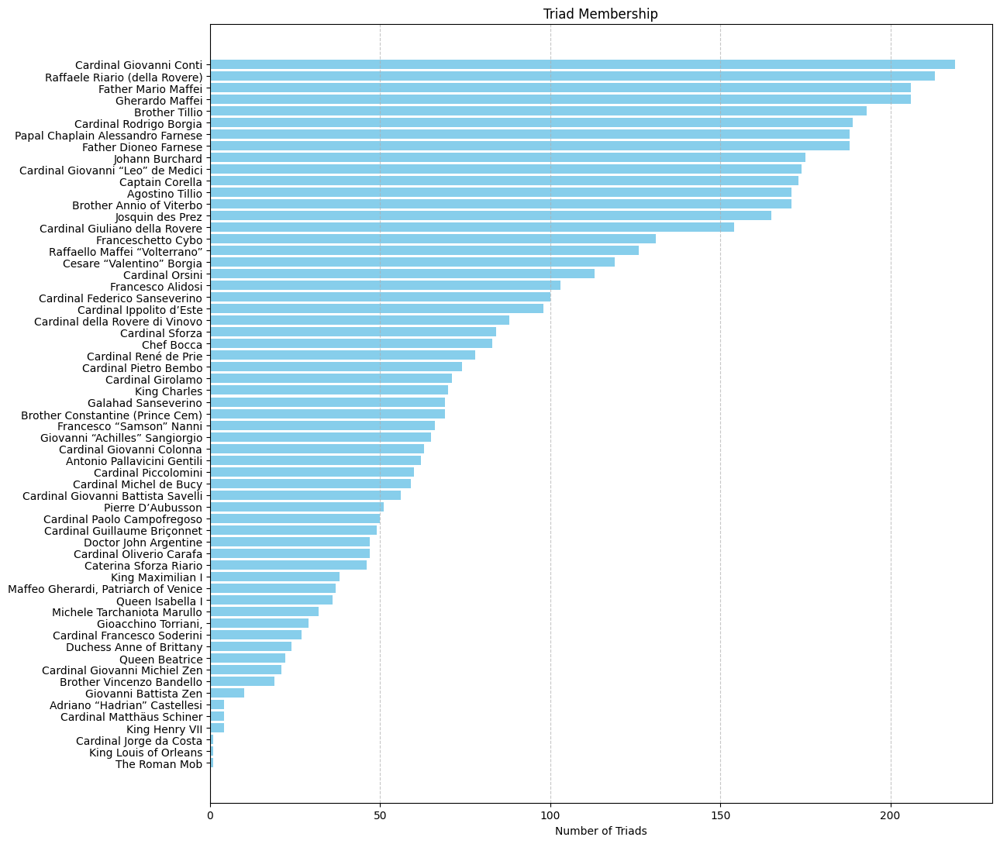

In [238]:
"""
Those in the most triangles (stable groups)
"""

nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()])

res = nx.triangles(nxG)
sorted_data = dict(sorted(res.items(), key=lambda item: item[1], reverse=True))
# for k, v in sorted_data.items():
#     print(f"{k}: {v}")

# Extract the names and values for plotting
names = list(sorted_data.keys())
values = list(sorted_data.values())

# Create the horizontal bar chart
plt.figure(figsize=(13, 11))
plt.barh(names, values, color='skyblue')
plt.xlabel('Number of Triads')
plt.title('Triad Membership')
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Invert the y-axis to have the highest values at the top
plt.gca().invert_yaxis()

# Show the plot
plt.tight_layout()
plt.show()


In [268]:
"""
Communities
"""

nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]
myweights = {"close ally": 10, "ally": 6, "confidant": 3, "client": 5, "correspondent": 1, "patron":5, "boss": 2, "colleague": 1}

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()], weight=myweights[key])

count = 0
res = nx.community.louvain_communities(nxG)
for itm in res:
    for a in itm:
        print(a)
        count +=1
    print('\n\n')

Brother Vincenzo Bandello
Queen Beatrice
Caterina Sforza Riario
Cardinal Sforza
Cardinal Paolo Campofregoso
Antonio Pallavicini Gentili
Cardinal Ippolito d’Este
Cardinal Oliverio Carafa
Galahad Sanseverino
Giovanni “Achilles” Sangiorgio
King Maximilian I
Gioacchino Torriani,
King Louis of Orleans
Cardinal Federico Sanseverino
Queen Isabella I



Giovanni Battista Zen
King Charles
Pierre D’Aubusson
Cardinal Pietro Bembo
King Henry VII
Cardinal René de Prie
Francesco “Samson” Nanni
Cardinal Jorge da Costa
Cardinal Michel de Bucy
Duchess Anne of Brittany
Cardinal Giovanni Michiel Zen
Cardinal Girolamo
Maffeo Gherardi, Patriarch of Venice
Cardinal Giuliano della Rovere
Michele Tarchaniota Marullo
Cardinal Matthäus Schiner
Cardinal della Rovere di Vinovo
Adriano “Hadrian” Castellesi
Cardinal Guillaume Briçonnet



Raffaele Riario (della Rovere)
Father Mario Maffei
Josquin des Prez
Captain Corella
Father Dioneo Farnese
Johann Burchard
Brother Tillio
Raffaello Maffei “Volterrano”
Gherardo Maf

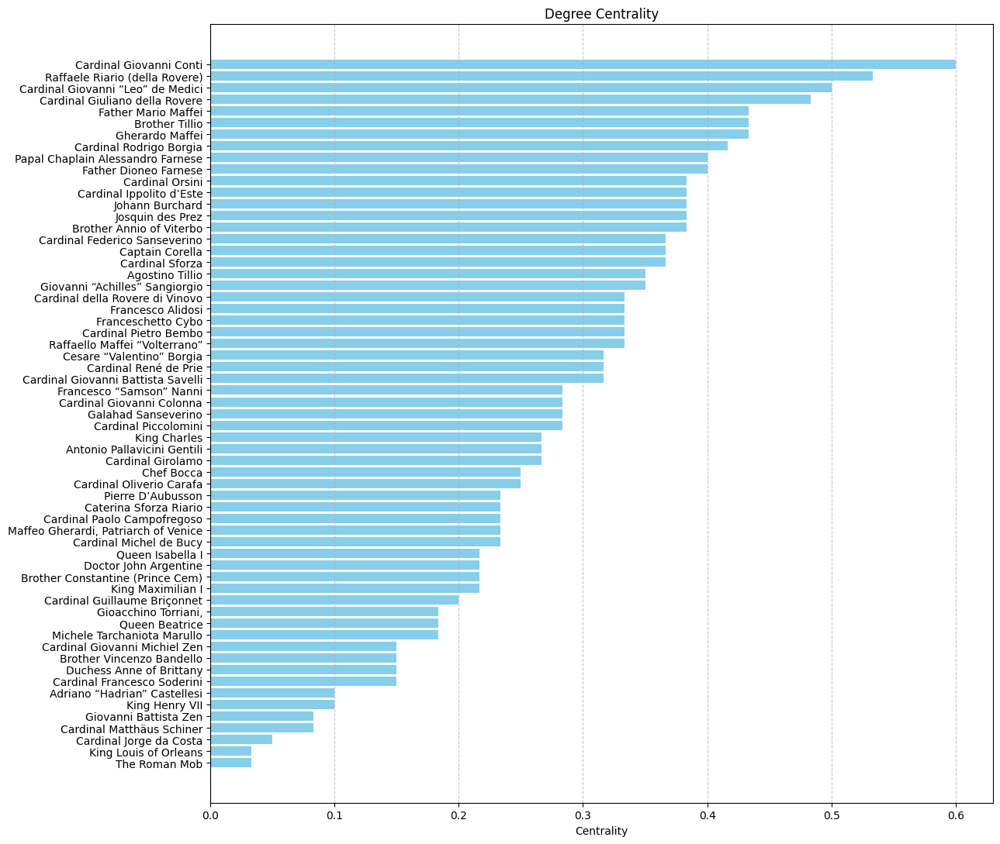

In [243]:
"""
Strongest individuals
"""

nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]
myweights = {"close ally": 5, "ally": 4, "confidant": 3, "client": 2, "correspondent": 1, "patron": 5, "boss": 2, "colleague": 1}

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms: # try toggling this!
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()], weight=myweights[key])

res = nx.degree_centrality(nxG)
sorted_data = dict(sorted(res.items(), key=lambda item: item[1], reverse=True))

# Extract the names and values for plotting
names = list(sorted_data.keys())
values = list(sorted_data.values())

# Create the horizontal bar chart
plt.figure(figsize=(13, 11))
plt.barh(names, values, color='skyblue')
plt.xlabel('Centrality')
plt.title('Degree Centrality')
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Invert the y-axis to have the highest values at the top
plt.gca().invert_yaxis()

# Show the plot
plt.tight_layout()
plt.show()

Cardinal Giovanni Conti: 0.22943375616367265
Raffaele Riario (della Rovere): 0.2184486512225759
Father Mario Maffei: 0.20819312391286476
Gherardo Maffei: 0.20819312391286476
Cardinal Giovanni “Leo” de Medici: 0.2066820712824268
Brother Tillio: 0.2054700345217306
Cardinal Rodrigo Borgia: 0.19908558996048606
Papal Chaplain Alessandro Farnese: 0.1984501204611698
Father Dioneo Farnese: 0.1984501204611698
Johann Burchard: 0.19040507364812106
Captain Corella: 0.1872764758002046
Josquin des Prez: 0.18647499793170502
Brother Annio of Viterbo: 0.18496132191514275
Agostino Tillio: 0.18319431443005718
Franceschetto Cybo: 0.16854239001080956
Raffaello Maffei “Volterrano”: 0.16775956052620508
Cardinal Orsini: 0.16539472826438506
Cesare “Valentino” Borgia: 0.15952860189545198
Francesco Alidosi: 0.15923181946802833
Cardinal Giuliano della Rovere: 0.15337315950217348
Chef Bocca: 0.1329136709221043
Cardinal Pietro Bembo: 0.12046016063412641
Brother Constantine (Prince Cem): 0.11821482469074958
Cardinal

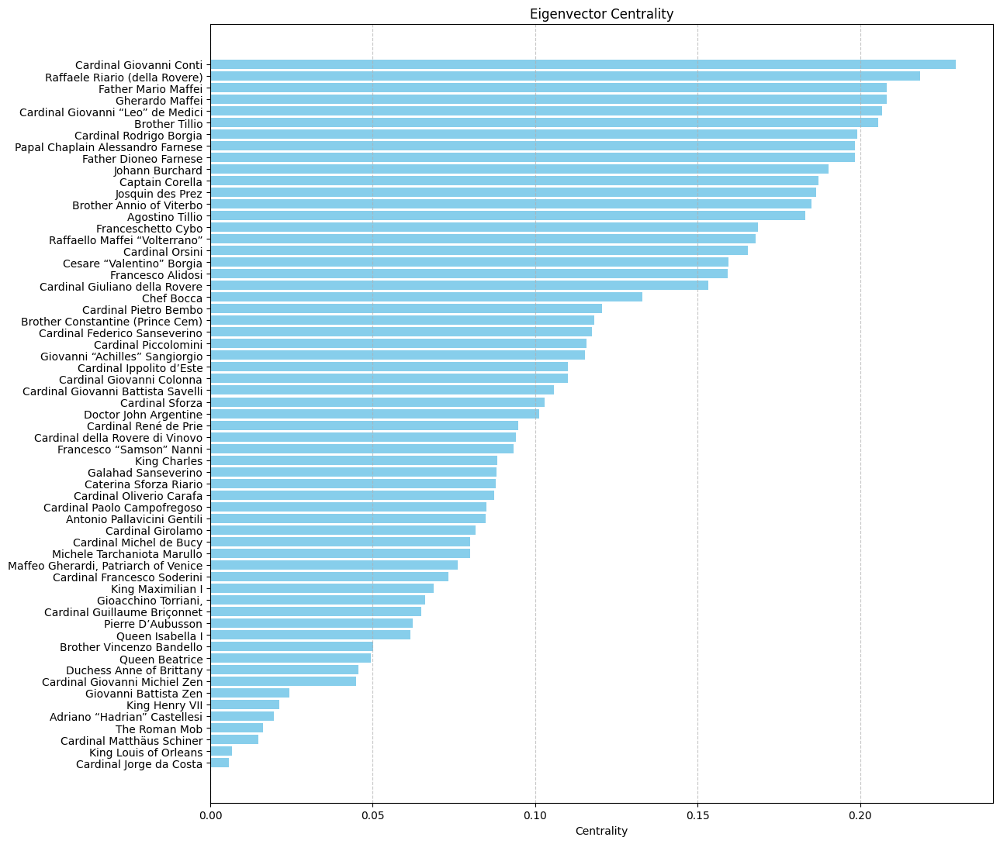

In [244]:
"""
Strongest individuals
"""

res = nx.eigenvector_centrality(nxG)
sorted_data = dict(sorted(res.items(), key=lambda item: item[1], reverse=True))
for k, v in sorted_data.items():
    print(f"{k}: {v}")

# Extract the names and values for plotting
names = list(sorted_data.keys())
values = list(sorted_data.values())

# Create the horizontal bar chart
plt.figure(figsize=(13, 11))
plt.barh(names, values, color='skyblue')
plt.xlabel('Centrality')
plt.title('Eigenvector Centrality')
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Invert the y-axis to have the highest values at the top
plt.gca().invert_yaxis()

# Show the plot
plt.tight_layout()
plt.show()

Cardinal Giovanni Conti: 0.7142857142857143
Raffaele Riario (della Rovere): 0.6666666666666666
Cardinal Giovanni “Leo” de Medici: 0.6666666666666666
Cardinal Giuliano della Rovere: 0.6451612903225806
Brother Tillio: 0.625
Cardinal Orsini: 0.6185567010309279
Father Mario Maffei: 0.6185567010309279
Cardinal Ippolito d’Este: 0.6185567010309279
Gherardo Maffei: 0.6185567010309279
Cardinal Federico Sanseverino: 0.6122448979591837
Cardinal Rodrigo Borgia: 0.6122448979591837
Cardinal Sforza: 0.6060606060606061
Papal Chaplain Alessandro Farnese: 0.6
Father Dioneo Farnese: 0.6
Johann Burchard: 0.6
Josquin des Prez: 0.6
Brother Annio of Viterbo: 0.6
Giovanni “Achilles” Sangiorgio: 0.594059405940594
Cardinal René de Prie: 0.5882352941176471
Captain Corella: 0.5882352941176471
Cardinal Pietro Bembo: 0.5882352941176471
Agostino Tillio: 0.5825242718446602
Cardinal della Rovere di Vinovo: 0.5769230769230769
Francesco Alidosi: 0.5769230769230769
Cardinal Giovanni Battista Savelli: 0.5769230769230769
R

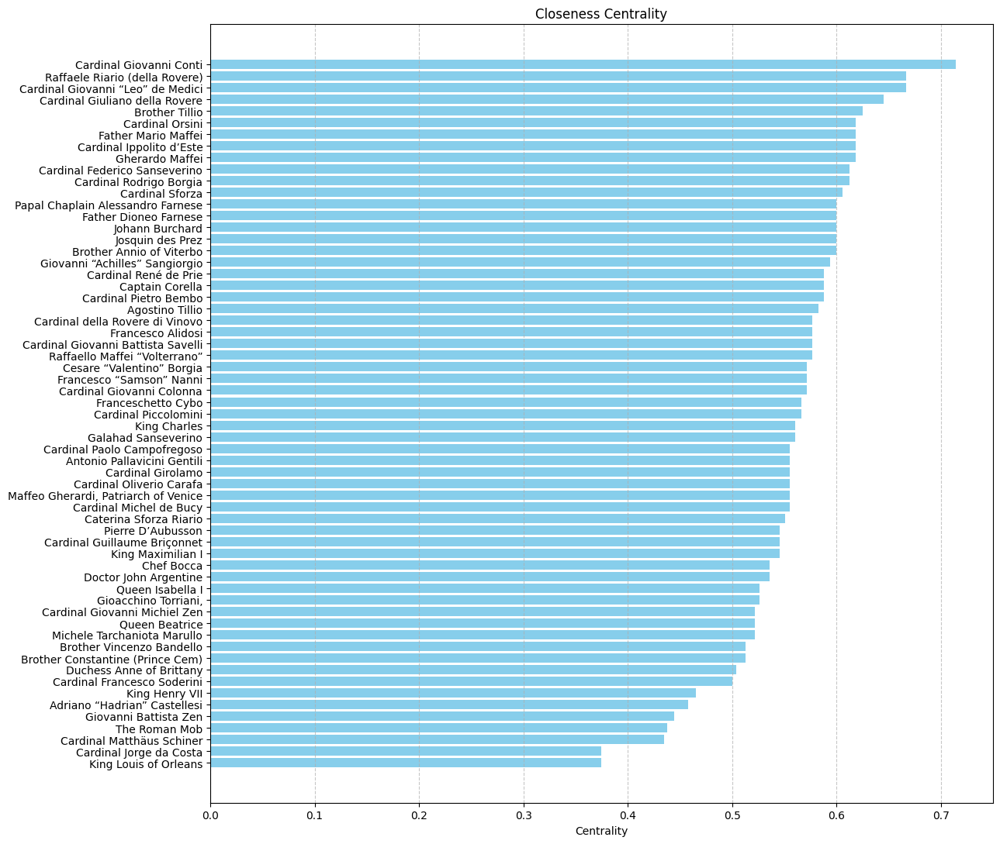

In [246]:
"""
The closest individals to other individuals
"""

res = nx.closeness_centrality(nxG)
sorted_data = dict(sorted(res.items(), key=lambda item: item[1], reverse=True))
for k, v in sorted_data.items():
    print(f"{k}: {v}")

# Extract the names and values for plotting
names = list(sorted_data.keys())
values = list(sorted_data.values())

# Create the horizontal bar chart
plt.figure(figsize=(13, 11))
plt.barh(names, values, color='skyblue')
plt.xlabel('Centrality')
plt.title('Closeness Centrality')
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Invert the y-axis to have the highest values at the top
plt.gca().invert_yaxis()

# Show the plot
plt.tight_layout()
plt.show()


1.8169398907103824


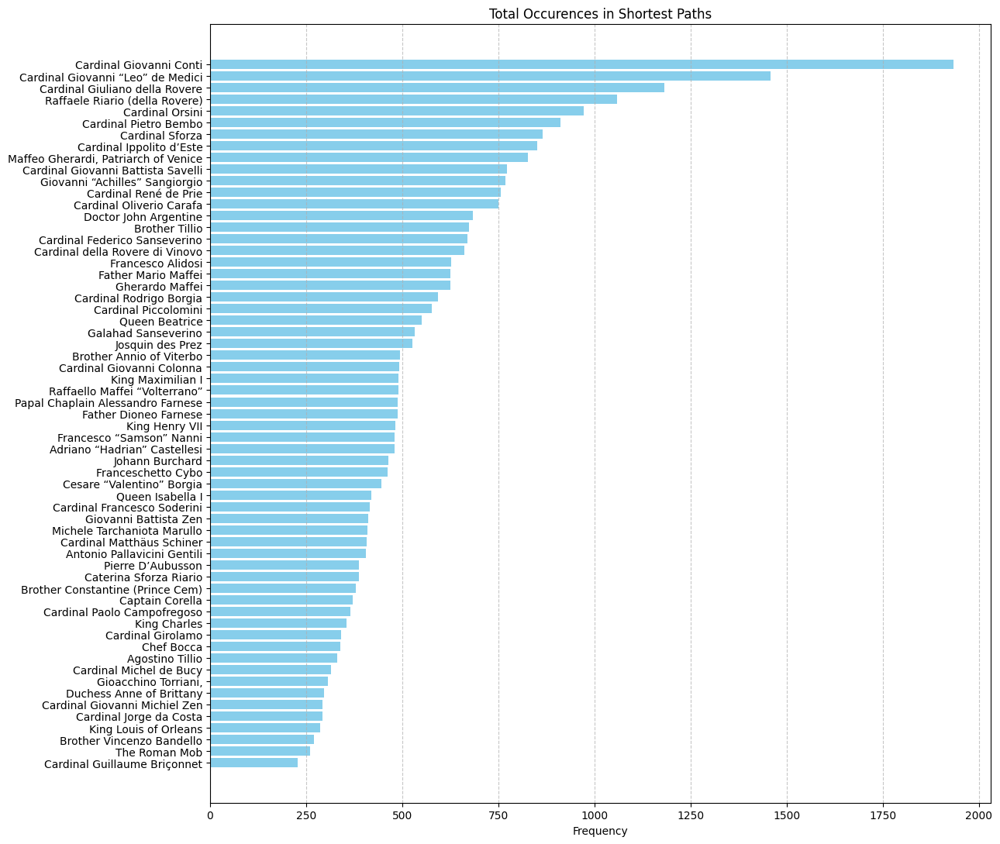

In [260]:
"""
Freq of occurence in shortest path
"""
nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]
myweights = {"close ally": 5, "ally": 4, "confidant": 3, "client": 2, "correspondent": 1, "patron": 5, "boss": 2, "colleague": 1}

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms: # try toggling this!
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()], weight=myweights[key])



res = nx.average_shortest_path_length(nxG)
print(res)

freq = {}
for person in nxG.nodes:
    for alt in nxG.nodes:
        for a in nx.all_shortest_paths(nxG, person, alt):
            for name in a[1:]:
                if name in freq:
                    freq[name] += 1
                else:
                    freq[name] = 1

sorted_data = dict(sorted(freq.items(), key=lambda item: item[1], reverse=True))

# Extract the names and values for plotting
names = list(sorted_data.keys())
values = list(sorted_data.values())

# Create the horizontal bar chart
plt.figure(figsize=(13, 11))
plt.barh(names, values, color='skyblue')
plt.xlabel('Frequency')
plt.title('Total Occurences in Shortest Paths')
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Invert the y-axis to have the highest values at the top
plt.gca().invert_yaxis()

# Show the plot
plt.tight_layout()
plt.show()

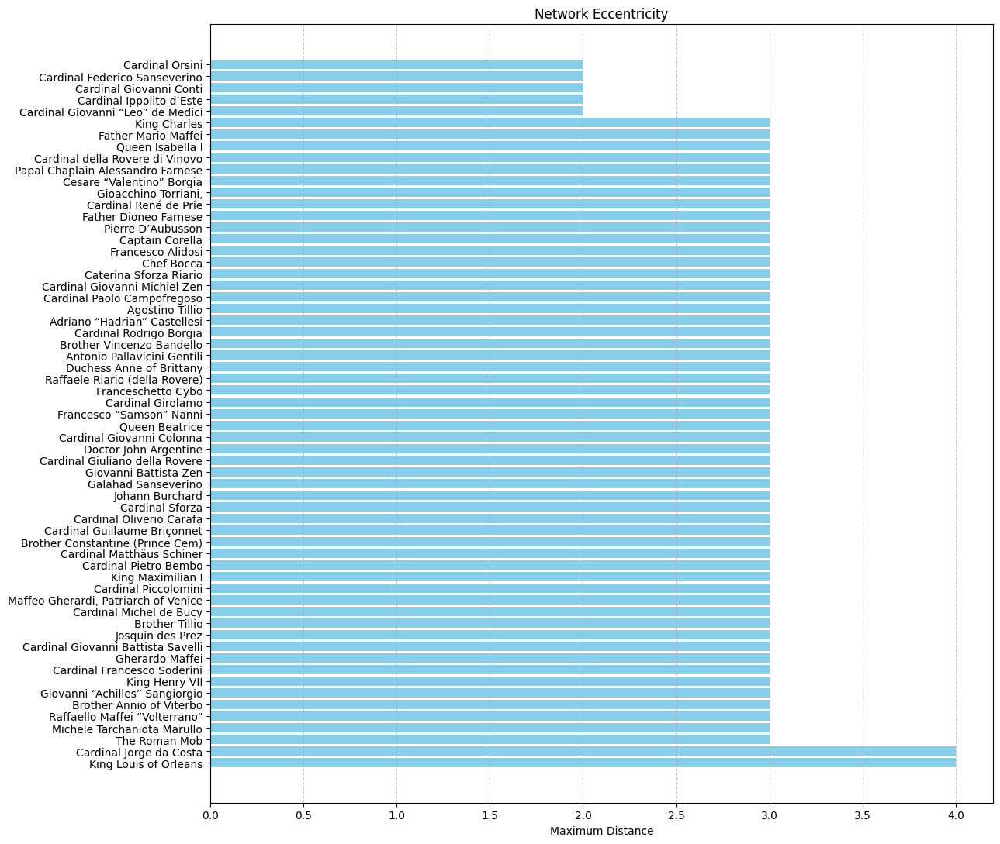

In [256]:
"""
Network eccentricity
"""
res = dict(nx.eccentricity(nxG))

sorted_data = dict(sorted(res.items(), key=lambda item: item[1]))

# Extract the names and values for plotting
names = list(sorted_data.keys())
values = list(sorted_data.values())

# Create the horizontal bar chart
plt.figure(figsize=(13, 11))
plt.barh(names, values, color='skyblue')
plt.xlabel('Maximum Distance')
plt.title('Network Eccentricity')
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Invert the y-axis to have the highest values at the top
plt.gca().invert_yaxis()

# Show the plot
plt.tight_layout()
plt.show()

In [196]:
"""
Pretty resistent to node stress tests,
though more on a local scale
"""
local = nx.local_efficiency(nxG)
globalvalue = nx.global_efficiency(nxG)
print(local, globalvalue)

0.7520969631436613 0.6249089253187616


In [221]:
nodes = nxG.nodes()
edges = nxG.edges()
print(len(nodes))
print(len(edges))

61
1018
